---
format: 
  html:
    toc: false
    page-layout: full
execute:
    echo: false
---

# Hotspot Clustering
## Introduction
This Jupyter Notebooks script performs k means clustering and data visualization on three data outputs from WeightedOverlayRasters, using them to make high-level planning recommendations for urban development and conservation prioritization.

Here are descriptions of the three datasets used in this analysis:

* **Bio_x_Risk** emphasizes areas of high land cover change probability and high biodiversity intactness.
    * *Bio_x_Risk = LCC_Probability x BII*
<br>

* **Anthro_x_Risk** emphasizes areas of high climate hazard probability and high human population.
    * *Anthro_x_Risk = Climate_Hazards x pop2020*
<br>

* **Urban Land Cover Probability** is a dataset generated using a random forest model trained on a range of physiographic factors to predict the likelihood of a raster cell to be urban in 2033.

In [1]:
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
import geopandas as gpd
np.random.seed(42)

import rasterio
from rasterio.enums import Resampling

from sklearn.cluster import DBSCAN
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import KMeans
from kneed import KneeLocator
import seaborn as sns
import plotly.express as px
import colorcet as cc
from mpl_toolkits.axes_grid1 import make_axes_locatable

## Data Formatting

Loading raster datasets and remove any NoData values that might be present

In [2]:
#| echo: true 
#| code-fold: true

# Load the raster datasets
AnthroRisk_path = '/Users/oliveratwood/Documents/GitHub/HotspotStoplight/clustering/data/AnthroRiskNorm.tif'
BioRisk_path = '/Users/oliveratwood/Documents/GitHub/HotspotStoplight/clustering/data/BioRiskNorm.tif'
UrbanProbability_path = '/Users/oliveratwood/Documents/GitHub/HotspotStoplight/clustering/data/UrbanProbability.tif'


with rasterio.open(AnthroRisk_path) as AnthroRisk_dataset:
    AnthroRisk = AnthroRisk_dataset.read(1)

transform = AnthroRisk_dataset.transform

# Function to read raster and replace NoData values
def read_raster_and_replace_nodata(path):
    with rasterio.open(path) as dataset:
        # Read the first band
        data = dataset.read(1)
        # Get the NoData value
        nodata_value = dataset.nodatavals[0]
        if nodata_value is not None:
            # Replace NoData values with NaN
            data = np.where(data == nodata_value, np.nan, data)
    return data

# Load the raster datasets and remove NoData values
AnthroRisk = read_raster_and_replace_nodata(AnthroRisk_path)
BioRisk = read_raster_and_replace_nodata(BioRisk_path)
UrbanProbability = read_raster_and_replace_nodata(UrbanProbability_path)


In [3]:
# # Function to get the resolution of a raster
# def get_raster_resolution(path):
#     with rasterio.open(path) as dataset:
#         # Extract the resolution from the transform
#         resolution = (abs(dataset.transform[0]), abs(dataset.transform[4])) # (cell width, cell height)
#     return resolution

# # Get the resolution of each raster
# Resolution = get_raster_resolution(AnthroRisk_path)

# # Print the resolutions
# print("Raster Resolution:", Resolution)



Plot datasets to be clustered

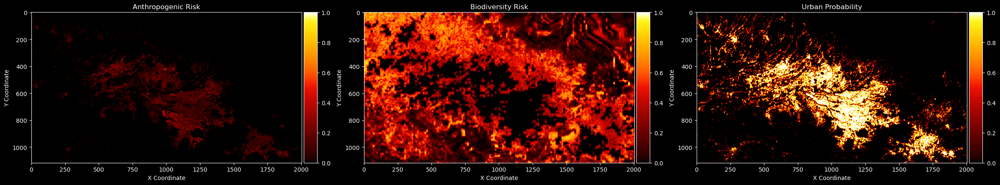

In [4]:
#| echo: true 
#| code-fold: true

# List of tuples containing raster datasets and their titles
raster_data = [
    (AnthroRisk, 'Anthropogenic Risk'),
    (BioRisk, 'Biodiversity Risk'),
    (UrbanProbability, 'Urban Probability'),
]

# Set a dark background style
plt.style.use('dark_background')

# Create a figure with 3 subplots (arranged horizontally)
fig, axs = plt.subplots(1, 3, figsize=(24, 8))  # Adjust the figure size as needed

# Loop through each raster dataset and plot in subplots
for i, (data, title) in enumerate(raster_data):
    im = axs[i].imshow(data, cmap=cc.cm.fire)  # Use Colorcet's 'fire' colormap
    axs[i].set_title(title, color='white')
    axs[i].set_xlabel('X Coordinate', color='white')
    axs[i].set_ylabel('Y Coordinate', color='white')

    # Create an axis for the colorbar
    divider = make_axes_locatable(axs[i])
    cax = divider.append_axes("right", size="5%", pad=0.05)

    # Add colorbar to the created axis
    fig.colorbar(im, cax=cax, orientation='vertical')

# Adjust layout to prevent overlap
plt.tight_layout()

# Display the plot
plt.show()



Merge the rasters into a single dataframe for clustering

In [5]:
#| echo: true 
#| code-fold: true

# Ensure all rasters have the same shape
assert AnthroRisk.shape == BioRisk.shape == UrbanProbability.shape, "Rasters must be of the same size"

# Get coordinates
rows, cols = np.indices(AnthroRisk.shape)
xs, ys = rasterio.transform.xy(transform, rows, cols)

# Dictionary of arrays
arrays = {
    'x': np.array(xs),
    'y': np.array(ys),
    'Anthropogenic_Risk': AnthroRisk,
    'Biodiversity_Risk': BioRisk,
    'Urban_Probability': UrbanProbability
}


# Flatten the arrays
flattened_arrays = {key: value.flatten() for key, value in arrays.items()}

# Create a DataFrame
df = pd.DataFrame(flattened_arrays)

# Drop NaN values if necessary
df.dropna(inplace=True)

# df.head()

Standardize the data columns for clustering

In [6]:
#| echo: true 
#| code-fold: true

# Standardization
standard_scaler = StandardScaler()
X = standard_scaler.fit_transform(df[['Anthropogenic_Risk', 'Biodiversity_Risk', 'Urban_Probability']])

## K-Means Clustering

Perform K-means clustering

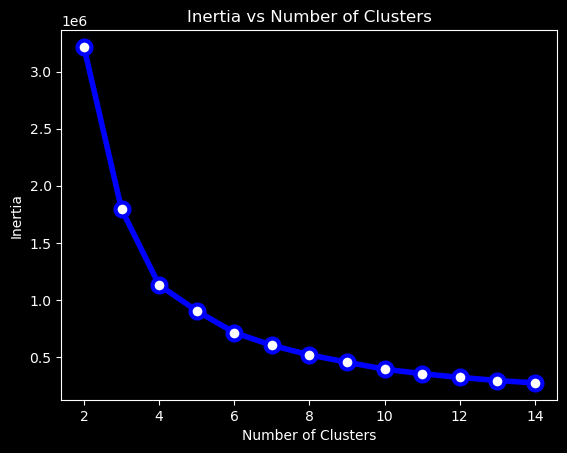

In [7]:
#| echo: true 
#| code-fold: true

# Number of clusters to try out
n_clusters = list(range(2, 15))

# Run kmeans for each value of k
inertias = []
for k in n_clusters:
    
    # Initialize and run
    kmeans = KMeans(n_clusters=k, n_init=10, max_iter=600)
    kmeans.fit(X)
    
    # Save the "inertia"
    inertias.append(kmeans.inertia_)
    
# Plot it!
# Set a dark background style for the plot
plt.style.use('dark_background')

# Plotting the data
plt.plot(n_clusters, inertias, marker='o', ms=10, mfc='white', lw=4, mew=3, color='blue')

# Setting labels and title with light color for visibility
plt.title('Inertia vs Number of Clusters', color='white')
plt.xlabel('Number of Clusters', color='white')
plt.ylabel('Inertia', color='white')

# Display the plot
plt.show()


Determine the appropriate number of clusters using KneeLocator

In [8]:
#| echo: true 
#| code-fold: true

# Initialize the knee algorithm
kn = KneeLocator(n_clusters, inertias, curve='convex', direction='decreasing')

# Print out the knee 
print(kn.knee)

4


Fit the appropriate number of clusters to the data

In [9]:
#| echo: true 
#| code-fold: true

# Initialize the Kmeans object
# Using the identified knee
kmeans = KMeans(n_clusters=(kn.knee), random_state=42, n_init=10)

# Using a manually-assigned knee
# kmeans = KMeans(n_clusters=4, random_state=42, n_init=10)

# Run the fit! This adds the ".labels_" attribute
kmeans.fit(X);

# Save the cluster labels
df["cluster"] = kmeans.labels_

df.head()

,x,y,Anthropogenic_Risk,Biodiversity_Risk,Urban_Probability,cluster
0,-84.389663,10.129249,0.0,0.668739,0.000073,0
1,-84.389385,10.129249,0.0,0.665026,0.000071,0
2,-84.389107,10.129249,0.0,0.661313,0.000083,0
3,-84.388829,10.129249,0.0,0.655744,0.000098,0
4,-84.388552,10.129249,0.0,0.653149,0.000103,0


In [10]:
#| echo: true 
#| code-fold: true

# Count the number of rows for each cluster and sort them to see which clusters have the greatest number of rows
cluster_counts = df['cluster'].value_counts().sort_values(ascending=False)

# Display the counts
print('Number of Pixels per Cluster')
print(cluster_counts)
# print(df.dtypes)

Number of Pixels per Cluster
1    971354
0    924702
2    228555
3    112740
Name: cluster, dtype: int64


Make a multi-bar chart for each cluster

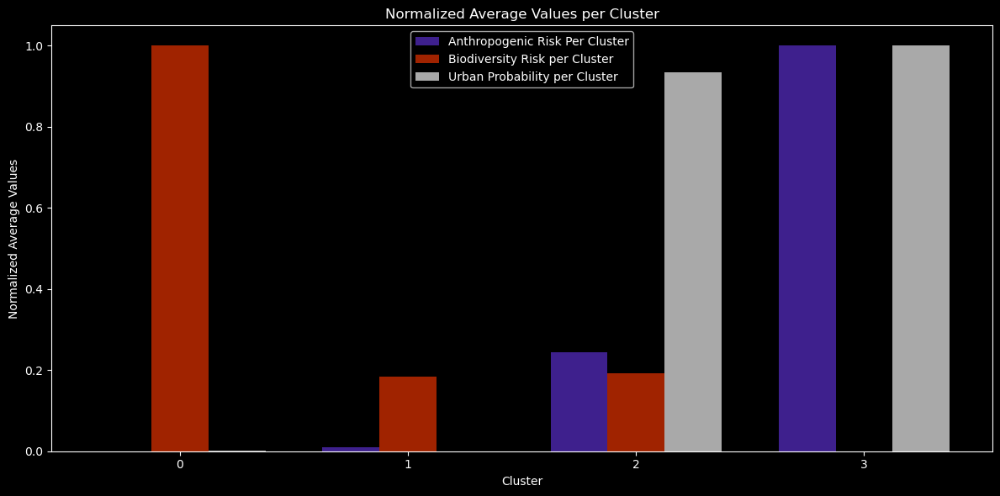

In [11]:
#| echo: true 
#| code-fold: true

# Group by 'cluster' and calculate mean for each column
cluster_summary = df.groupby('cluster')[['Anthropogenic_Risk', 'Biodiversity_Risk', 'Urban_Probability']].mean()

# Normalize the data
cluster_summary_normalized = (cluster_summary - cluster_summary.min()) / (cluster_summary.max() - cluster_summary.min())

# Set dark mode style
plt.style.use('dark_background')

# Define the number of groups and bar width
n_groups = len(cluster_summary_normalized)
bar_width = 0.25

# Define x coordinates for each group
index = np.arange(n_groups)
x1 = index - bar_width
x2 = index
x3 = index + bar_width

# Plotting each column in grouped bars
fig, ax = plt.subplots(figsize=(12, 6))

# Titles and colors for each plot
columns = ['Anthropogenic_Risk', 'Biodiversity_Risk', 'Urban_Probability']
colors = ['#3e208d', '#a02300', 'darkgrey']
plot_titles = ['Anthropogenic Risk Per Cluster', 'Biodiversity Risk per Cluster', 'Urban Probability per Cluster']

# Use a for loop to create each group of bars
for x, color, column, title in zip([x1, x2, x3], colors, columns, plot_titles):
    ax.bar(x, cluster_summary_normalized[column], bar_width, label=title, color=color)

# Add titles, labels, and legend
ax.set_title('Normalized Average Values per Cluster', color='white')
ax.set_xlabel('Cluster', color='white')
ax.set_ylabel('Normalized Average Values', color='white')
ax.legend()

# Set x-ticks to be in the middle of the group of bars
ax.set_xticks(index)
ax.set_xticklabels(cluster_summary.index)

# Adjust layout and show plot
plt.tight_layout()
plt.show()

Here we see how each one of the clusters is composed of a different combination of values of each index we're clustering on.<br>
Let's put together some high-level takeaways about the implications of each of these.<br>
## Findings of Analysis
* Land in Cluster 0 should be considered for <span style="color: #cd0000; font-weight: bold;">conservation</span>, as this means they have a high combination of land cover change probability and biodiversity.
    * *No Anthropogenic Risk, High Biodiversity Risk, No Probability of Urban Land Cover*
* Land in Cluster 1 can be thought of as <span style="color: #336633; font-weight: bold;">regional landscape assets</span>. Their low risk level makes conservation a lower prioirty, but minimizing human impact on these lands will help maintain regional biodiversity.
    * *No Anthropogenic Risk, Low Biodiversity Risk, No Probability of Urban Land Cover*
* Land in Cluster 2 is the most suitable for <span style="color: #A9A9A9; font-weight: bold;">urban development</span> out of the four clusters, since anthropogenic risk and biodiversity risk are relatively low there.
    * *Low Anthropogenic Risk, Low Biodiversity Risk, High Probability of Urban Land Cover
* Land in Cluster 3 should be considered for <span style="color: #277bdb; font-weight: bold;">Nature-Based Solutions</span> (NbS) implementation, such as green stormwater infrastructure, either in the form of retrofits or included in areas of new urban development. 
    * *High Anthropogenic Risk, No Biodiversity Risk, High Probability of Urban Land Cover

## Final Visualizations

Plot the clusters across space

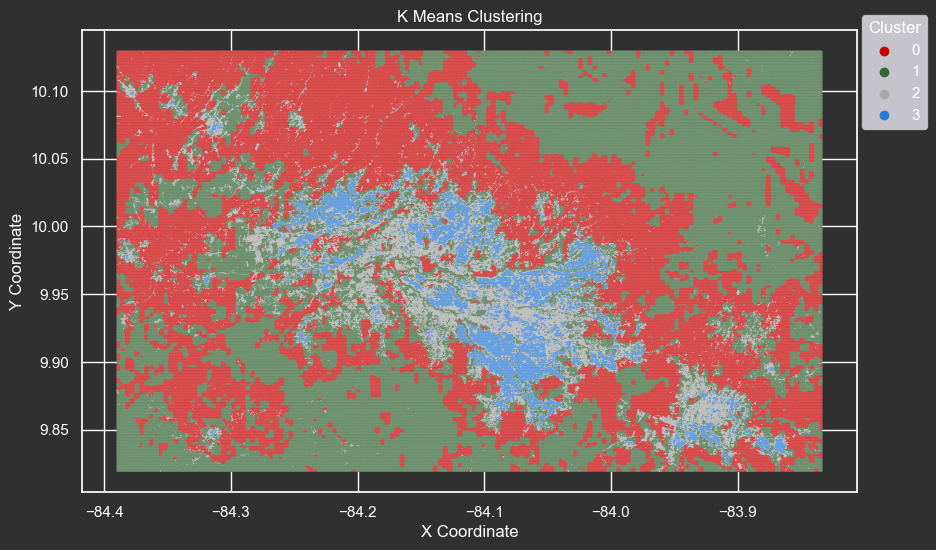

In [12]:
#| echo: true 
#| code-fold: true

# Set the style of the visualization with a dark background
sns.set(style="darkgrid")

custom_palette = {
    0: '#cd0000',
    1: '#336633',
    2: '#A9A9A9',
    3: '#277bdb',
}

# Create a scatter plot with the custom palette
plt.figure(figsize=(10, 6))
scatter = sns.scatterplot(
    x='x', 
    y='y', 
    hue='cluster', 
    palette=custom_palette, 
    data=df, 
    s=0.5  # Point size
)

# Adding title and labels with a light color for visibility against the dark background
plt.title('K Means Clustering', color='white')
plt.xlabel('X Coordinate', color='white')
plt.ylabel('Y Coordinate', color='white')

# Change the color of ticks and labels for visibility
plt.xticks(color='white')
plt.yticks(color='white')

# Modify legend for better visibility on dark background
legend = plt.legend(title='Cluster', loc='upper right', bbox_to_anchor=(1.1, 1.05), frameon=True)
plt.setp(legend.get_texts(), color='white')  # Set the legend text color
plt.setp(legend.get_title(), color='white')  # Set the legend title color

# Set the face and edge color of the figure to match the dark theme
plt.gcf().set_facecolor('#303030')
plt.gca().set_facecolor('#303030')
plt.gca().spines['top'].set_color('white')
plt.gca().spines['bottom']. set_color('white')
plt.gca().spines['left'].set_color('white')
plt.gca().spines['right'].set_color('white')

# Display the plot
plt.show()


This plot shows us how there are two types of clusters in the urban area and two types of clustes in the non-urban area.

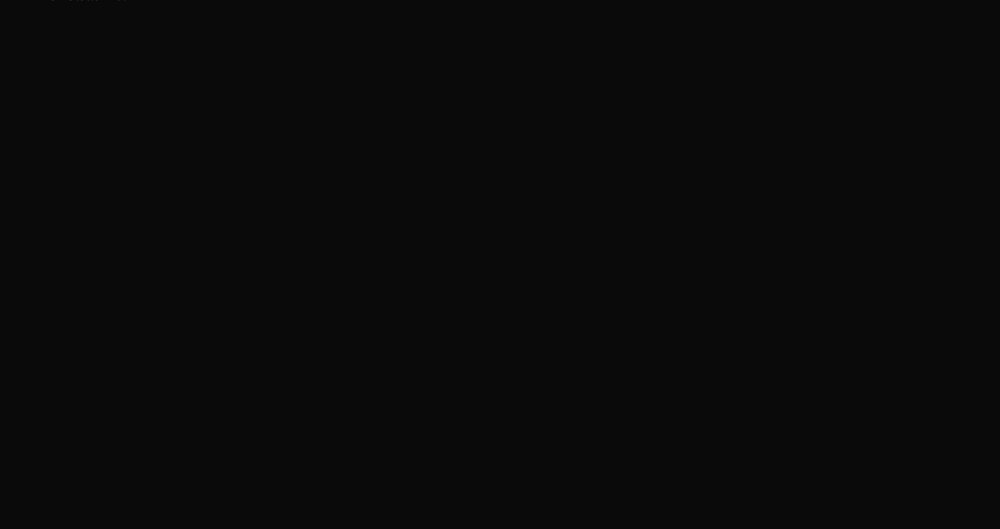

In [13]:
#| echo: true 
#| code-fold: true

# Sample the DataFrame at 5%
sampled_df = df.sample(frac=0.05)

# Create a 3D scatter plot using Plotly
fig = px.scatter_3d(
    sampled_df,
    x='Anthropogenic_Risk',
    y='Biodiversity_Risk',
    z='Urban_Probability',
    title='3D Scatter Plot',
    labels={
        'Anthropogenic_Risk': 'Anthropogenic Risk Index',
        'Biodiversity_Risk': 'Biodiversity Risk Index',
        'Urban_Probability': 'Suitability of Urban Land Cover',
        'cluster': 'Cluster'
    }
)

# Update marker colors and hover information directly
fig.update_traces(
    marker=dict(
        size=1.5,
        color=[custom_palette[c] for c in sampled_df['cluster']],
        opacity=0.75
    ),
    hovertemplate="Anthropogenic Risk: %{x}<br>Biodiversity Risk: %{y}<br>Urban Probability: %{z}<br>Cluster: %{customdata}"
)

# Add custom data for hover information
fig.update_traces(customdata=sampled_df['cluster'])


# Update the layout for dark mode
fig.update_layout(
    margin=dict(l=0, r=0, b=0, t=0),
    paper_bgcolor='rgb(10,10,10)',
    plot_bgcolor='rgb(10,10,10)',
    title_font_color='white',
    font_color='white',
    height=900,
    width=1600,
    scene=dict(
        xaxis=dict(
            backgroundcolor='rgb(32,32,32)',
            gridcolor='gray',
            showbackground=True,
            zerolinecolor='gray'),
        yaxis=dict(
            backgroundcolor='rgb(32,32,32)',
            gridcolor='gray',
            showbackground=True,
            zerolinecolor='gray'),
        zaxis=dict(
            backgroundcolor='rgb(32,32,32)',
            gridcolor='gray',
            showbackground=True,
            zerolinecolor='gray'),
    )
)

# Show the plot
fig.show()


This interactive plot allows us to visualize each of the factors as it varies within the cluster.<br>
Try zooming in and rotating!

In [14]:
# import geopandas as gpd
# from shapely.geometry import Point

# # Convert DataFrame to GeoDataFrame
# gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df['x'], df['y']))
# # Save as GeoJSON or Shapefile:
# gdf.to_file("./data/output.geojson", driver='GeoJSON')


In [15]:
# import folium
# import geopandas as gpd
# import json
# import pyproj
# from shapely.geometry import Point
# from shapely.ops import transform

# # Load GeoDataFrame from GeoJSON
# gdf = gpd.read_file("./data/output.geojson")

# # Calculate bounds of the GeoDataFrame
# bounds = gdf.total_bounds  # [minx, miny, maxx, maxy]

# # Calculate the center
# center_lat = (bounds[1] + bounds[3]) / 2
# center_lon = (bounds[0] + bounds[2]) / 2

# # Create a Folium map centered at the calculated location
# m = folium.Map(location=[center_lat, center_lon], zoom_start=10)

# # Load the GeoJSON data
# with open("./data/output.geojson") as f:
#     geojson_data = json.load(f)

# # Add the GeoJSON data to the map
# folium.GeoJson(
#     geojson_data,
#     name='geojson'
# ).add_to(m)

# # Optionally, add layer control to toggle GeoJSON layer
# folium.LayerControl().add_to(m)

# # Display the map
# m
